# Sonification of f0 Annotations
In this notebook, we illustrate the sonification of fundamental frequency annotations using the ```libsoni.core.f0``` module.

In [1]:
import numpy as np
import pandas as pd
import os
import librosa
from IPython import display as ipd
import json

from libsoni.core.f0 import sonify_f0, sonify_f0_with_presets, sonify_f0_dev
from libsoni.core.methods import generate_tone_instantaneous_phase
from libsoni.util.utils import mix_sonification_and_original, get_preset

Fs = 22050

AUDIO_DIR = 'data_audio'
CSV_DIR = 'data_csv'

## Simple Scenario: C Major Triad
To start with a simple example, let's look at the fundamental frequencies of a **C major triad**.
<img src="figures/demo_f0/C-Dur-DM.png" alt="C-Major-Triad" width="250">
The frequencies corresponding to the notes are:

| Note | Frequency (Hz) |
|------|----------------|
| C4   |     261.63     |
| E4   |     329.63     |
| G4   |     392.00     |
| C5   |     523.25     |

In [2]:
# Define list of frequencies for C Major triad
C_Major_Triad_f0s = [261.63, 329.63, 392.00, 523.25, 0.0]

To sonify these notes, or more precisely their frequencies, we need an array of time positions at which the notes are to be played. Let's play the first note at 0.25 seconds for 0.5 seconds and all other notes consecutively for 0.5 seconds as well.

In [3]:
# Define starting time position in seconds
start_sec = 0.25

# Define duration for each frequency
duration_note_sec = 0.5

# Create array from time information
time_positions = np.arange(start_sec, len(C_Major_Triad_f0s) * duration_note_sec, duration_note_sec)

The function ```sonify_f0``` from the module ```f0``` takes a Nx2-dimensional ```numpy.ndarray``` containing the time positions in the first column and the f0s in the second column.

In [4]:
# Create Nx2-dimenstioinal numpy.ndarray time_f0
time_f0 = np.column_stack((time_positions, C_Major_Triad_f0s))

# Display time_f0 as Pandas DataFrame
time_f0_df = pd.DataFrame(np.column_stack((time_positions, C_Major_Triad_f0s)), columns =['start','f0'])
ipd.display(time_f0_df)

,start,f0
0,0.25,261.63
1,0.75,329.63
2,1.25,392.00
3,1.75,523.25
4,2.25,0.00


### Sonified C Major Triad

In [5]:
# Parameters
frequency = 10.0  # Frequency of the sine wave in Hz
duration_seconds = 2.25  # Duration of the sine wave in seconds

# Calculate the number of samples based on duration
num_samples = int(Fs * duration_seconds)

# Create a time array
t = np.linspace(0, duration_seconds, num_samples, endpoint=False)

# Generate the sine wave
sinusoid = np.sin(2 * np.pi * frequency * t)


# Generate the sine wave
sinusoid = np.sin(2 * np.pi * frequency * t)


gains = [0,1,0,1,0]

sonified_C_Major_Triad_f0 = sonify_f0_dev(time_f0=time_f0,gains=gains, fs=Fs)


print('Sonified C Major triad:')
ipd.display(ipd.Audio(sonified_C_Major_Triad_f0, rate=Fs))

Sonified C Major triad:


### Customizing the Sonification
To adjust the sonification, the function ```sonify_f0``` offers the possibility to set the so-called partial frequencies as well as their amplitudes to create a certain timbre. Let's say we want to use the fundamental frequency f0 as well as two times, three times and four times the fundamental frequency for sonification. For the amplitudes we want to set 1, 1/2, 1/3, 1/4.

| Custom frequencies | Custom amplitudes |
|--------------------|------------------|
| f0                 | 1                |
| 2*f0               | 1/2              |
| 3*f0               | 1/3              |
| 4*f0               | 1/4              |

In [6]:
# Set custom_partials
custom_partials = np.array([1,2,3,4])

# Set amplitudes for custom_partials
custom_partials_amplitudes = np.array([1,1/2,1/3,1/4])

# Sonification with custom parital settings using libsoni
sonified_C_Major_Triad_f0 = sonify_f0(time_f0=time_f0,
                                      partials=custom_partials,
                                      partials_amplitudes=custom_partials_amplitudes,
                                      fs=Fs)


print('Sonified C Major Triad with custom parials:')
ipd.display(ipd.Audio(sonified_C_Major_Triad_f0, rate=Fs))

Sonified C Major Triad with custom parials:


### Working with Presets
Since the above way of customizing sounds seems a bit unintuitive and more suitable for computational applications, the ```libsoni.f0``` module also offers the possibility to work with presets. In the following we illustrate this approach with our Bach example.
*(To view the different presets, see ```libsoni/utils/presets.json```)*

In [7]:
# get information about preset 
violin_preset = get_preset('violin')
ipd.display(violin_preset)

{'amplitudes': [0.3952569169960475,
  0.23715415019762848,
  0.11857707509881424,
  0.0790513833992095,
  0.05928853754940712,
  0.03952569169960475,
  0.0316205533596838,
  0.019762845849802375,
  0.011857707509881424,
  0.00790513833992095],
 'envelope': None,
 'partials': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]}

In order to get an overview of all the presets to choose among, we give some short examples:

In [8]:
with open(os.path.join('libsoni', 'util', 'presets.json'), "r+") as jsonFile:
    PRESETS = json.load(jsonFile)

time_f0_a4_1second = np.column_stack((np.array([0,1]), np.array([440,0])))    

for preset in PRESETS:
    partials = np.array(PRESETS[preset]['partials'])
    amplitudes = np.array(PRESETS[preset]['amplitudes'])
    
    audio_example = sonify_f0(time_f0_a4_1second, partials=partials, partials_amplitudes=amplitudes)
    print(preset)
    ipd.display(ipd.Audio(audio_example, rate=Fs))

alto


bass


bassoon


clarinet


saxophone


soprano


tenor


violin


sinusoid


## Scenario 1: *Ach Gott und Herr* by *J.S. Bach*
"Ach Gott und Herr" is a sacred choral composition by the Baroque composer Johann Sebastian Bach, taken from. The piece typically features a four-part choir, supported by an instrumental ensemble. Bach often employed various instrumental combinations to enhance the choral texture and evoke different emotional layers. The following excerpt comprises a violin, a clarinet, a saxophone and a bassoon. This example is taken from the <a href="https://ieeexplore.ieee.org/document/5404324">Bach10</a> dataset.



<img src="figures/demo_f0/01-AchGottundHerr_score.png" alt="Locus Iste" width="500" height="800">

In [9]:
bach_audio, _ = librosa.load(os.path.join(AUDIO_DIR,'demo_f0','01-AchGottundHerr.wav'), sr=Fs)

print('"Ach Gott und Herr", by J. S. Bach:')
ipd.display(ipd.Audio(bach_audio, rate=Fs))

"Ach Gott und Herr", by J. S. Bach:


### Preparing the Data
For the excerpt above, we load the corresponding .csv tables containing the time and f0 information for each instrument.

In [10]:
# Load .csv-data for each instrument
violin_df = pd.read_csv(os.path.join(CSV_DIR,'demo_f0','01-AchGottundHerr_violin.csv'), sep=';')
clarinet_df = pd.read_csv(os.path.join(CSV_DIR,'demo_f0','01-AchGottundHerr_clarinet.csv'), sep=';')
saxophone_df = pd.read_csv(os.path.join(CSV_DIR,'demo_f0','01-AchGottundHerr_saxophone.csv'), sep=';')
bassoon_df = pd.read_csv(os.path.join(CSV_DIR,'demo_f0','01-AchGottundHerr_bassoon.csv'), sep=';')

print('Extract from violin_df:')
ipd.display(violin_df.iloc[100:105])

Extract from violin_df:


,start,f0
100,1.00,494.484541
101,1.01,495.252512
102,1.02,498.796651
103,1.03,498.796651
104,1.04,498.796651


,start,f0,confidence
0,0.00,462.345098,0.040279
1,0.01,468.410770,0.016807
2,0.02,463.234680,0.101269
3,0.03,461.107365,0.028188
4,0.04,459.389696,0.037094
...,...,...,...
14537,145.37,596.312781,0.052553
14538,145.38,619.420220,0.080831
14539,145.39,645.997237,0.071255
14540,145.40,657.325663,0.082946


(14542, 3)


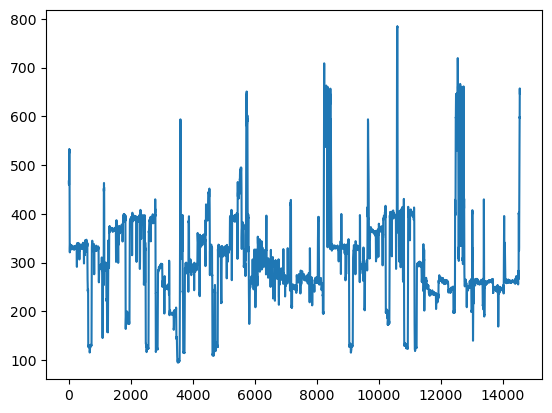

In [11]:
testconf_df = pd.read_csv(os.path.join(CSV_DIR,'demo_f0','DCS_LI_QuartetA_Take01_A1_LRX_with_confidence.csv'), sep=';')
ipd.display(testconf_df)
from matplotlib import pyplot as plt
x = testconf_df.to_numpy()
plt.plot(x[:,1])
print(x.shape)

145.41   0


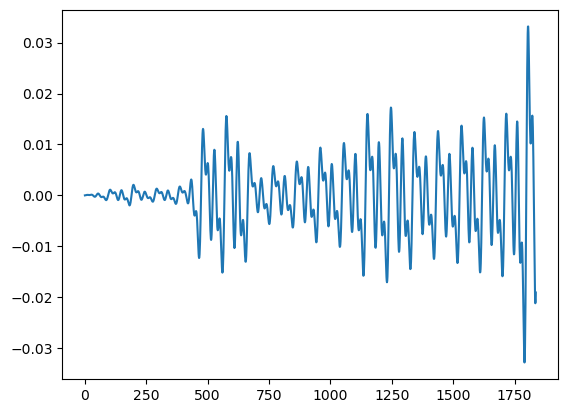

In [12]:
time_positions = testconf_df['start'].to_numpy()
f0s = testconf_df['f0'].to_numpy()
gains = testconf_df['confidence'].to_numpy()

num_samples = int(time_positions[-1] * Fs)

f0s_stretched = np.zeros(num_samples)
f0_sonification = np.zeros(num_samples)
gains_stretched = np.zeros(num_samples)
shorter_duration = False
for i, (time, f0, gain) in enumerate(zip(time_positions, f0s, gains)):
    if i == time_positions.shape[0] - 1:
        if not shorter_duration:
            f0s_stretched[int(time_positions[i] * Fs):] = 0.0
            gains_stretched[int(time_positions[i] * Fs):] = 0.0
    else:
        next_time = time_positions[i+1]
        f0s_stretched[int(time*Fs):int(next_time*Fs)] = f0
        gains_stretched[int(time*Fs):int(next_time*Fs)] = gain

print(time_positions[-1], ' ', int(len(gains)/Fs))

x = generate_tone_instantaneous_phase(frequency_vector = f0s_stretched,
                                      gain_vector = gains_stretched,
                                      partials = [0.5,1,2],
                                      partials_amplitudes = [0.3,0.4,0.3],
                                      #partials_phase_offsets, 
                                      fs=Fs,
                                      fading_sec=0.2)
plt.plot(x[:int(Fs/12)])
ipd.display(ipd.Audio(x,rate=Fs))

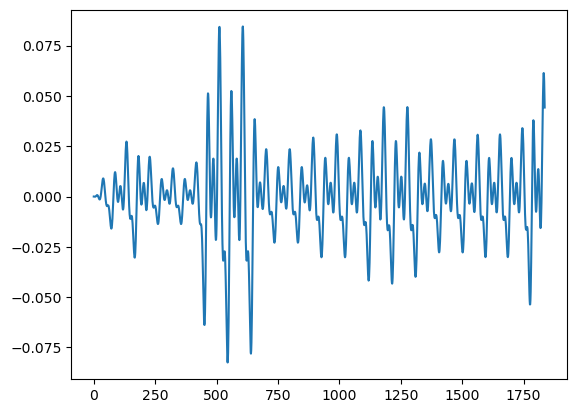

In [13]:
x2 = generate_tone_instantaneous_phase(frequency_vector = f0s_stretched,
                                      gain_vector = gains_stretched,
                                      partials = [0.5,1,2],
                                      partials_amplitudes = [0.3,0.4,0.3],
                                      partials_phase_offsets = [0, 3/4 * np.pi, 2], 
                                      fs=Fs,
                                      fading_sec=0.01)
plt.plot(x2[:int(Fs/12)])
ipd.display(ipd.Audio(x2,rate=Fs))

For the sonification of f0 annotations with presets we use the function ```sonify_f0_with_presets``` from ```libsoni.f0```. This function takes a dictionary with presets as key with a Nx2-dimensional ```numpy.ndarray``` containing time and f0 information as value. 

In [14]:
# Create dictionary
bach_dict = {
    'soprano':{
        'preset':'violin',
        'time_f0':violin_df.to_numpy(),
        'gain':1.0
    },
    'alto':{
        'preset':'clarinet',
        'time_f0':clarinet_df.to_numpy(),
        'gain':1.0
    },
    'tenor':{
        'preset':'saxophone',
        'time_f0':saxophone_df.to_numpy(),
        'gain':1.0
    },
    'bass':{
        'preset':'bassoon',
        'time_f0':bassoon_df.to_numpy(),
        'gain':1.0
    }
}

ipd.display(bach_dict)

{'soprano': {'preset': 'violin',
  'time_f0': array([[0.  , 0.  ],
         [0.01, 0.  ],
         [0.02, 0.  ],
         ...,
         [6.57, 0.  ],
         [6.58, 0.  ],
         [6.59, 0.  ]]),
  'gain': 1.0},
 'alto': {'preset': 'clarinet',
  'time_f0': array([[0.  , 0.  ],
         [0.01, 0.  ],
         [0.02, 0.  ],
         ...,
         [6.57, 0.  ],
         [6.58, 0.  ],
         [6.59, 0.  ]]),
  'gain': 1.0},
 'tenor': {'preset': 'saxophone',
  'time_f0': array([[0.  , 0.  ],
         [0.01, 0.  ],
         [0.02, 0.  ],
         ...,
         [6.57, 0.  ],
         [6.58, 0.  ],
         [6.59, 0.  ]]),
  'gain': 1.0},
 'bass': {'preset': 'bassoon',
  'time_f0': array([[0.  , 0.  ],
         [0.01, 0.  ],
         [0.02, 0.  ],
         ...,
         [6.57, 0.  ],
         [6.58, 0.  ],
         [6.59, 0.  ]]),
  'gain': 1.0}}

### Sonification

In [15]:
bach_sonified = sonify_f0_with_presets(bach_dict)

bach_sonified_w_original = mix_sonification_and_original(sonification=bach_sonified,
                                                         original_audio=bach_audio,
                                                         gain_lin_sonification=1.0,
                                                         gain_lin_original_audio=0.5)

print('Original audio:')
ipd.display(ipd.Audio(bach_audio, rate=Fs))

print('Sonified with libsoni:')
ipd.display(ipd.Audio(bach_sonified, rate=Fs))

print('Original audio with sonification (stereo):')
ipd.display(ipd.Audio(bach_sonified_w_original, rate=Fs))

Original audio:


Sonified with libsoni:


Original audio with sonification (stereo):


## Scenario 2: 'SATB'  *Locus Iste* by *Anton Bruckner* 
"Locus Iste" is a sacred motet composed by Anton Bruckner, a renowned Austrian composer of the Romantic era. This composition, often performed in choral settings, showcases Bruckner's mastery of harmonies and expressive depth.
"SATB" is an abbreviation used to describe the voicing and arrangement of a choir in choral music. It stands for Soprano, Alto, Tenor, and Bass, representing the four main vocal ranges in a choir. When applied to "Locus Iste" by Anton Bruckner, which is a choral composition, SATB signifies how the voices are organized and distributed within the piece. This example is taken from the <a href="https://www.audiolabs-erlangen.de/resources/MIR/2020-DagstuhlChoirSet">Dagstuhl Choirset</a>.

<img src="figures/demo_f0/Locus_iste_score.png" alt="Locus Iste" width="500">

In [16]:
satb_audio, _ = librosa.load(os.path.join(AUDIO_DIR,
                                          'demo_f0',
                                          'DCS_LI_QuartetA_Take04_StereoReverb_STM.wav'), sr=Fs)

print('"Locus Iste" by Anton Bruckner:')
ipd.display(ipd.Audio(satb_audio, rate=Fs))

"Locus Iste" by Anton Bruckner:


### Preparing the Data
For the excerpt above, we load the corresponding .csv tables containing the time and f0 information for each voice.

In [17]:
# Load .csv-data for each instrument
soprano_df = pd.read_csv(os.path.join(CSV_DIR,'demo_f0','DCS_LI_QuartetA_Take04_S2_LRX.csv'), sep=';')
alto_df = pd.read_csv(os.path.join(CSV_DIR,'demo_f0','DCS_LI_QuartetA_Take04_A1_LRX.csv'), sep=';')
tenor_df = pd.read_csv(os.path.join(CSV_DIR,'demo_f0','DCS_LI_QuartetA_Take04_T1_LRX.csv'), sep=';')
bass_df = pd.read_csv(os.path.join(CSV_DIR,'demo_f0','DCS_LI_QuartetA_Take04_B1_LRX.csv'), sep=';')

print('Extract from soprano_df:')
ipd.display(soprano_df.iloc[100:105])

Extract from soprano_df:


,start,f0
100,0.580499,532.093
101,0.586304,531.004
102,0.592109,530.270
103,0.597914,529.670
104,0.603719,529.322


As in the previous example, we again arrange the data as a dictionary. This time we use the presets **soprano**, **alto**, **tenor** and **bass**.

In [18]:
# Create dictionary
satb_dict = {
    'soprano':{
        'preset':'soprano',
        'time_f0':soprano_df.to_numpy(),
        'gain':1.0
    },
    'alto':{
        'preset':'alto',
        'time_f0':alto_df.to_numpy(),
        'gain':1.0
    },
    'tenor':{
        'preset':'tenor',
        'time_f0':tenor_df.to_numpy(),
        'gain':1.0
    },
    'bass':{
        'preset':'bass',
        'time_f0':bass_df.to_numpy(),
        'gain':1.0
    }
}

satb_sonified = sonify_f0_with_presets(satb_dict)

satb_sonified_w_original = mix_sonification_and_original(sonification=satb_sonified,
                                                         original_audio=satb_audio,
                                                         gain_lin_original_audio=0.05)

print('Original audio:')
ipd.display(ipd.Audio(satb_audio, rate=Fs))

print('Sonified with libsoni')
ipd.display(ipd.Audio(satb_sonified, rate=Fs))

print('Original audio with sonification (stereo)')
ipd.display(ipd.Audio(satb_sonified_w_original, rate=Fs))

Original audio:


Sonified with libsoni


Original audio with sonification (stereo)


## References

**[1]** Zhiyao Duan, Bryan Pardo and Changshui Zhang, “Multiple fundamental frequency estimation by modeling spectral peaks and non-peak regions,” IEEE Transactions of Audio Speech Language Process., vol. 18, no. 8, pp. 2121–2133, 2010.

**[2]** S. Rosenzweig, H. Cuesta, C. Weiß, F. Scherbaum, E. Gómez, and M. Müller, “Dagstuhl ChoirSet: A multitrack dataset for MIR research on choral singing,” Transactions of the International Society for Music Information Retrieval (TISMIR), vol. 3, no. 1, pp. 98–110, 2020.